### Introduction

Every year the Nobel Prize is given to scientists and scholars in the categories chemistry, literature, physics, physiology or medicine, economics, and peace.


Let's see what patterns we can find in the data of the past Nobel laureates.

In [59]:
%pip install --upgrade plotly
import pandas as pd
import numpy as np
import plotly.express as px
import seaborn as sns
import matplotlib.pyplot as plt

### Notebook Presentation

In [60]:
pd.options.display.float_format = '{:,.2f}'.format

### Read the Data

In [61]:
df_data = pd.read_csv('nobel_prize_data.csv')

# Data Exploration & Cleaning


In [62]:
df_data.shape

(962, 16)

In [63]:
df_data.head()

,year,category,prize,motivation,prize_share,laureate_type,full_name,birth_date,birth_city,birth_country,birth_country_current,sex,organization_name,organization_city,organization_country,ISO
0,1901,Chemistry,The Nobel Prize in Chemistry 1901,"""in recognition of the extraordinary services ...",1/1,Individual,Jacobus Henricus van 't Hoff,1852-08-30,Rotterdam,Netherlands,Netherlands,Male,Berlin University,Berlin,Germany,NLD
1,1901,Literature,The Nobel Prize in Literature 1901,"""in special recognition of his poetic composit...",1/1,Individual,Sully Prudhomme,1839-03-16,Paris,France,France,Male,NaN,NaN,NaN,FRA
2,1901,Medicine,The Nobel Prize in Physiology or Medicine 1901,"""for his work on serum therapy, especially its...",1/1,Individual,Emil Adolf von Behring,1854-03-15,Hansdorf (Lawice),Prussia (Poland),Poland,Male,Marburg University,Marburg,Germany,POL
3,1901,Peace,The Nobel Peace Prize 1901,NaN,1/2,Individual,Frédéric Passy,1822-05-20,Paris,France,France,Male,NaN,NaN,NaN,FRA
4,1901,Peace,The Nobel Peace Prize 1901,NaN,1/2,Individual,Jean Henry Dunant,1828-05-08,Geneva,Switzerland,Switzerland,Male,NaN,NaN,NaN,CHE


### Check for Duplicates

In [64]:
df_data.duplicated().values.any()

False

### Check for NaN Values

In [65]:
df_data.isna().values.any()

True

In [66]:
df_data.isna().sum()

year                       0
category                   0
prize                      0
motivation                88
prize_share                0
laureate_type              0
full_name                  0
birth_date                28
birth_city                31
birth_country             28
birth_country_current     28
sex                       28
organization_name        255
organization_city        255
organization_country     254
ISO                       28
dtype: int64

In [67]:
col_subset=['year','category','laureate_type','birth_date','full_name','organization_name']
df_data.loc[df_data.birth_date.isna()][col_subset]

,year,category,laureate_type,birth_date,full_name,organization_name
24,1904,Peace,Organization,NaN,Institut de droit international (Institute of ...,NaN
60,1910,Peace,Organization,NaN,Bureau international permanent de la Paix (Per...,NaN
89,1917,Peace,Organization,NaN,Comité international de la Croix Rouge (Intern...,NaN
200,1938,Peace,Organization,NaN,Office international Nansen pour les Réfugiés ...,NaN
215,1944,Peace,Organization,NaN,Comité international de la Croix Rouge (Intern...,NaN
237,1947,Peace,Organization,NaN,American Friends Service Committee (The Quakers),NaN
238,1947,Peace,Organization,NaN,Friends Service Council (The Quakers),NaN
283,1954,Peace,Organization,NaN,Office of the United Nations High Commissioner...,NaN
348,1963,Peace,Organization,NaN,Comité international de la Croix Rouge (Intern...,NaN
349,1963,Peace,Organization,NaN,Ligue des Sociétés de la Croix-Rouge (League o...,NaN


In [68]:
col_subset=['year','category','laureate_type','birth_date','full_name','organization_name']
df_data.loc[df_data.organization_name.isna()][col_subset]

,year,category,laureate_type,birth_date,full_name,organization_name
1,1901,Literature,Individual,1839-03-16,Sully Prudhomme,NaN
3,1901,Peace,Individual,1822-05-20,Frédéric Passy,NaN
4,1901,Peace,Individual,1828-05-08,Jean Henry Dunant,NaN
7,1902,Literature,Individual,1817-11-30,Christian Matthias Theodor Mommsen,NaN
9,1902,Peace,Individual,1843-05-21,Charles Albert Gobat,NaN
...,...,...,...,...,...,...
932,2018,Peace,Individual,1993-07-02,Nadia Murad,NaN
942,2019,Literature,Individual,1942-12-06,Peter Handke,NaN
946,2019,Peace,Individual,1976-08-15,Abiy Ahmed Ali,NaN
954,2020,Literature,Individual,1943-04-22,Louise Glück,NaN


### Type Conversions


#### Convert Year and Birth Date to Datetime

In [69]:
df_data.birth_date=pd.to_datetime(df_data.birth_date)

#### Add a Column with the Prize Share as a Percentage

In [70]:
separated_values=df_data.prize_share.str.split('/',expand=True)
numerator=pd.to_numeric(separated_values[0])
denomenator=pd.to_numeric(separated_values[1])
df_data['share_pct']=numerator/denomenator

In [71]:
df_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 962 entries, 0 to 961
Data columns (total 17 columns):
 #   Column                 Non-Null Count  Dtype         
---  ------                 --------------  -----         
 0   year                   962 non-null    int64         
 1   category               962 non-null    object        
 2   prize                  962 non-null    object        
 3   motivation             874 non-null    object        
 4   prize_share            962 non-null    object        
 5   laureate_type          962 non-null    object        
 6   full_name              962 non-null    object        
 7   birth_date             934 non-null    datetime64[ns]
 8   birth_city             931 non-null    object        
 9   birth_country          934 non-null    object        
 10  birth_country_current  934 non-null    object        
 11  sex                    934 non-null    object        
 12  organization_name      707 non-null    object        
 13  organ

#  Percentage of Male vs. Female Laureates

I created a donut chart using Plotly that illustrates the distribution of prizes between men and women.

In [72]:
def enable_plotly_in_cell():
  import IPython
  from plotly.offline import init_notebook_mode
  display(IPython.core.display.HTML('''<script src="/static/components/requirejs/require.js"></script>'''))
  init_notebook_mode(connected=False)

In [73]:
bio=df_data.sex.value_counts()
bio
fig=px.pie(labels=bio.index,
           values=bio.values,
           title="Percentage of Male vs Female winners",
           names=bio.index,
           hole=0.4)
enable_plotly_in_cell()
fig.update_traces(textposition='inside',textfont_size=15,textinfo='percent')
fig.show()

/usr/local/lib/python3.10/dist-packages/plotly/express/_core.py:140: FutureWarning:

Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.



We observe that out of all Nobel laureates since 1901, only approximately 6.2% were women

##first 3 Women to Win the Nobel Prize:


In [74]:
df_data[df_data.sex=='Female'].sort_values('year',ascending=True)[:3]

,year,category,prize,motivation,prize_share,laureate_type,full_name,birth_date,birth_city,birth_country,birth_country_current,sex,organization_name,organization_city,organization_country,ISO,share_pct
18,1903,Physics,The Nobel Prize in Physics 1903,"""in recognition of the extraordinary services ...",1/4,Individual,"Marie Curie, née Sklodowska",1867-11-07,Warsaw,Russian Empire (Poland),Poland,Female,NaN,NaN,NaN,POL,0.25
29,1905,Peace,The Nobel Peace Prize 1905,NaN,1/1,Individual,"Baroness Bertha Sophie Felicita von Suttner, n...",1843-06-09,Prague,Austrian Empire (Czech Republic),Czech Republic,Female,NaN,NaN,NaN,CZE,1.00
51,1909,Literature,The Nobel Prize in Literature 1909,"""in appreciation of the lofty idealism, vivid ...",1/1,Individual,Selma Ottilia Lovisa Lagerlöf,1858-11-20,Mårbacka,Sweden,Sweden,Female,NaN,NaN,NaN,SWE,1.00


## Identify winners who have won the prize two or more times.


In [75]:
is_winner=df_data.duplicated(subset=['full_name'],keep=False)
multiple_winners=df_data[is_winner]
print(f"There are {multiple_winners.full_name.nunique()} winners who were awarded the prize more than once")

There are 6 winners who were awarded the prize more than once


In [76]:
col_subset=['year','category','laureate_type','full_name']
multiple_winners[col_subset]

,year,category,laureate_type,full_name
18,1903,Physics,Individual,"Marie Curie, née Sklodowska"
62,1911,Chemistry,Individual,"Marie Curie, née Sklodowska"
89,1917,Peace,Organization,Comité international de la Croix Rouge (Intern...
215,1944,Peace,Organization,Comité international de la Croix Rouge (Intern...
278,1954,Chemistry,Individual,Linus Carl Pauling
283,1954,Peace,Organization,Office of the United Nations High Commissioner...
297,1956,Physics,Individual,John Bardeen
306,1958,Chemistry,Individual,Frederick Sanger
340,1962,Peace,Individual,Linus Carl Pauling
348,1963,Peace,Organization,Comité international de la Croix Rouge (Intern...


##Identifying the various categories in which prizes have been awarded.
created a Plotly bar chart depicting the number of prizes awarded by category.


In [77]:
df_data.category.unique()

array(['Chemistry', 'Literature', 'Medicine', 'Peace', 'Physics',
       'Economics'], dtype=object)

In [78]:
prize_per_category=df_data.category.value_counts()
v_bar=px.bar(
    x=prize_per_category.index,
    y=prize_per_category.values,
    color=prize_per_category.values,
    color_continuous_scale='aggrnyl',
    title='Number of Prizes Awarded per Category'

)
enable_plotly_in_cell()
v_bar.update_layout(xaxis_title='Noble Prize Category',
                    coloraxis_showscale=False,
                    yaxis_title='Number of Prizes')
v_bar.show()

The category with the highest number of awarded prizes is medicine.<br>
The category with the lowest number of awarded prizes is Economics.

In [79]:
df_data[df_data.category=='Economics'].sort_values('year')[:3]

,year,category,prize,motivation,prize_share,laureate_type,full_name,birth_date,birth_city,birth_country,birth_country_current,sex,organization_name,organization_city,organization_country,ISO,share_pct
393,1969,Economics,The Sveriges Riksbank Prize in Economic Scienc...,"""for having developed and applied dynamic mode...",1/2,Individual,Jan Tinbergen,1903-04-12,the Hague,Netherlands,Netherlands,Male,The Netherlands School of Economics,Rotterdam,Netherlands,NLD,0.50
394,1969,Economics,The Sveriges Riksbank Prize in Economic Scienc...,"""for having developed and applied dynamic mode...",1/2,Individual,Ragnar Frisch,1895-03-03,Oslo,Norway,Norway,Male,University of Oslo,Oslo,Norway,NOR,0.50
402,1970,Economics,The Sveriges Riksbank Prize in Economic Scienc...,"""for the scientific work through which he has ...",1/1,Individual,Paul A. Samuelson,1915-05-15,"Gary, IN",United States of America,United States of America,Male,Massachusetts Institute of Technology (MIT),"Cambridge, MA",United States of America,USA,1.00


## Male Vs Female Winners by Category


In [80]:
men_women_cat=df_data.groupby(['category','sex'],as_index=False).agg({'prize':pd.Series.count})
men_women_cat.sort_values('prize',ascending=False,inplace=True)
men_women_cat

,category,sex,prize
11,Physics,Male,212
7,Medicine,Male,210
1,Chemistry,Male,179
5,Literature,Male,101
9,Peace,Male,90
3,Economics,Male,84
8,Peace,Female,17
4,Literature,Female,16
6,Medicine,Female,12
0,Chemistry,Female,7


I have created a Plotly bar chart displaying the distribution between men and women across different categories.

In [81]:
v_bar_split=px.bar(x=men_women_cat.category,
                   y=men_women_cat.prize,
                   color=men_women_cat.sex,
                   title="Number of Prizes Awarded per Category split by Men and Women"
                   )
v_bar_split.update_layout(xaxis_title="Noble Prize Category",
                          yaxis_title="Number of prizes")
enable_plotly_in_cell()
v_bar_split.show()

We observe a significant overall imbalance, particularly in Physics, Economics, and Chemistry. Women are relatively better represented in the categories of Medicine, Literature, and Peace. Creating separate bar charts like this provides a powerful means to depict a more granular picture.

# Number of Prizes Awarded Over Time



In [82]:
prize_per_year=df_data.groupby('year').count().prize

In [83]:
moving_avg=prize_per_year.rolling(window=5).mean()
moving_avg

year
1901     NaN
1902     NaN
1903     NaN
1904     NaN
1905    6.20
        ... 
2016   11.60
2017   12.00
2018   12.00
2019   12.20
2020   12.40
Name: prize, Length: 117, dtype: float64

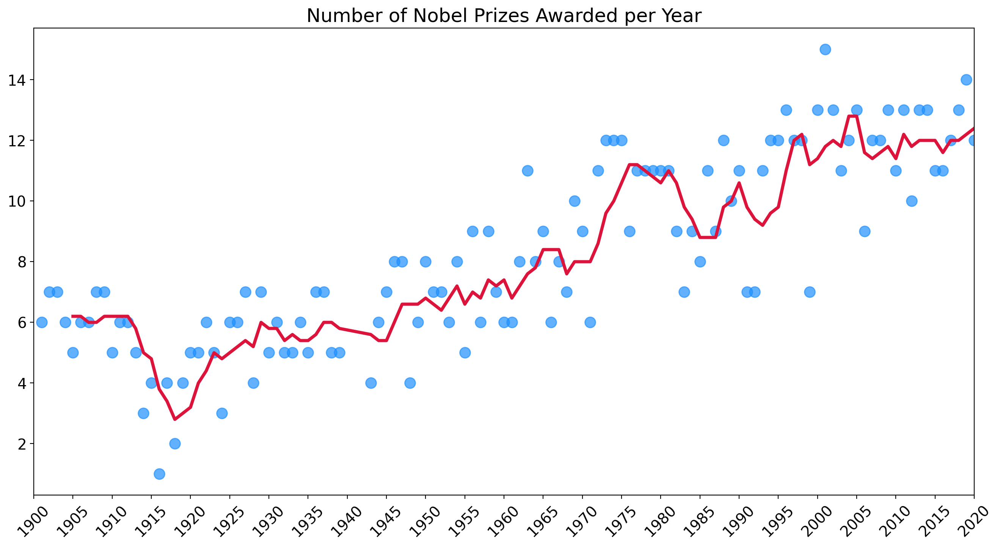

In [85]:
plt.figure(figsize=(16,8),dpi=200)
plt.title('Number of Nobel Prizes Awarded per Year',fontsize=18)
plt.yticks(fontsize=14)
plt.xticks(ticks=np.arange(1900,2021,step=5),
           fontsize=14,
           rotation=45)
ax=plt.gca()
ax.set_xlim(1900,2020)

ax.scatter(x=prize_per_year.index,
            y=prize_per_year.values,
            color='dodgerblue',
            alpha=0.7,
            s=100
            )

ax.plot(prize_per_year.index,
         moving_avg.values,
         c='crimson',
         linewidth=3

         )
plt.show()

Through visualization, we can conclude that more prizes have been awarded recently compared to when the prize was first created.

# Are More Prizes Shared Than Before?
Investigating if more prizes are currently being awarded compared to before.




In [86]:
yearly_avg_share=df_data.groupby('year').agg({'share_pct':pd.Series.mean})

share_moving_average=yearly_avg_share.rolling(window=5).mean()


In [ ]:
plt.figure(figsize=(16,8),dpi=200)
plt.title("Number of Nobel Prizes Awarded per Year",fontsize=18)
plt.yticks(fontsize=14)
plt.xticks(ticks=np.arange(1900,2021,step=5),
           fontsize=14,
           rotation=45)

ax1=plt.gca()
ax2=ax1.twinx()
ax1.set_xlim(1900,2020)

ax1.scatter(x=prize_per_year.index,
            y=prize_per_year.values,
            c='dodgerblue',
            alpha=0.7,
            s=100)
ax1.plot(prize_per_year.index,
         moving_avg.values,
         c='crimson',
         linewidth=3)
ax2.plot(prize_per_year.index,
         share_moving_average.values,
         c='grey',
         linewidth=3)
plt.show()

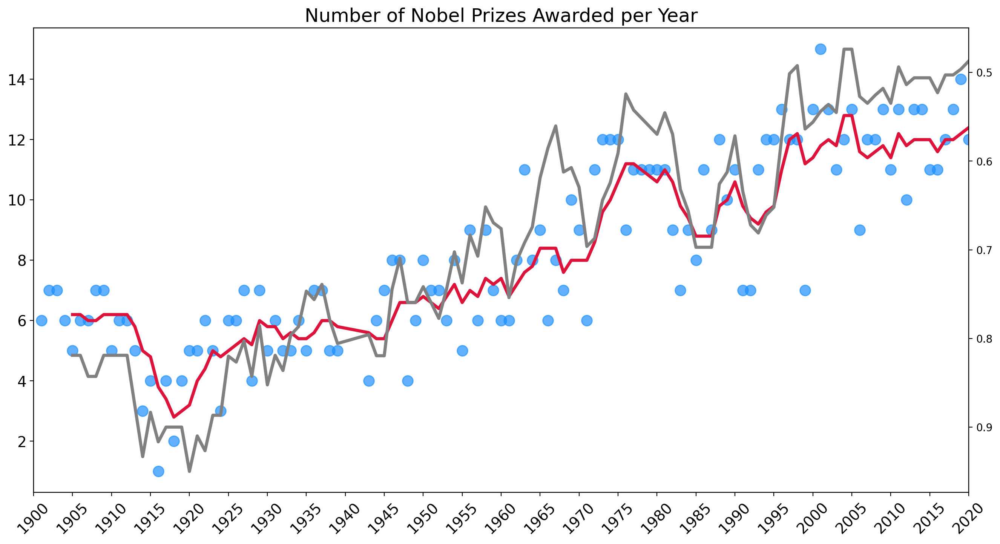

In [88]:
plt.figure(figsize=(16,8),dpi=200)
plt.title("Number of Nobel Prizes Awarded per Year",fontsize=18)
plt.yticks(fontsize=14)
plt.xticks(ticks=np.arange(1900,2021,step=5),
           fontsize=14,
           rotation=45)

ax1=plt.gca()
ax2=ax1.twinx()
ax1.set_xlim(1900,2020)
ax2.invert_yaxis()
ax1.scatter(x=prize_per_year.index,
            y=prize_per_year.values,
            c='dodgerblue',
            alpha=0.7,
            s=100)
ax1.plot(prize_per_year.index,
         moving_avg.values,
         c='crimson',
         linewidth=3)
ax2.plot(prize_per_year.index,
         share_moving_average.values,
         c='grey',
         linewidth=3)
plt.show()

# The Countries with the Most Nobel Prizes

In [89]:
top_countries=df_data.groupby(['birth_country_current'],as_index=False).agg({'prize':pd.Series.count})
top_countries.sort_values('prize',inplace=True)
top20_countries=top_countries[-20:]
top20_countries

,birth_country_current,prize
7,Belgium,9
31,Hungary,9
33,India,9
2,Australia,10
20,Denmark,12
54,Norway,12
13,China,12
51,Netherlands,18
3,Austria,18
39,Italy,19


In [ ]:
h_bar=px.bar(x=top20_countries.prize,
             y=top20_countries.birth_country_current,
             orientation='h',
             color=top20_countries.prize,
             color_continuous_scale='Viridis',
             title="Top20 Countries by Number of Prizes")
h_bar.update_layout(xaxis_title='Prizes',
                    yaxis_title='Countries',
                    coloraxis_showscale=False)
enable_plotly_in_cell()
h_bar.show()

#Choropleth Map to Show the Number of Prizes Won by Country
I created this choropleth map using Plotly.



In [91]:
df_countries=df_data.groupby(['birth_country_current','ISO'],as_index=False).agg({'prize':pd.Series.count})
df_countries.sort_values('prize',ascending=False)
df_countries

,birth_country_current,ISO,prize
0,Algeria,DZA,2
1,Argentina,ARG,4
2,Australia,AUS,10
3,Austria,AUT,18
4,Azerbaijan,AZE,1
...,...,...,...
74,United States of America,USA,281
75,Venezuela,VEN,1
76,Vietnam,VNM,1
77,Yemen,YEM,1


In [ ]:
world=px.choropleth(df_countries,
                    locations='ISO',
                    color='prize',
                    hover_name='birth_country_current',
                    color_continuous_scale=px.colors.sequential.matter)
enable_plotly_in_cell()
world.update_layout(coloraxis_showscale=True)
world.show()

## Analyze the data based on categories and various countries.

In [93]:
cat_country=df_data.groupby(['birth_country_current','category'],as_index=False).agg({'prize':pd.Series.count})
cat_country.sort_values('prize',ascending=False,inplace=True)
cat_country

,birth_country_current,category,prize
204,United States of America,Medicine,78
206,United States of America,Physics,70
201,United States of America,Chemistry,55
202,United States of America,Economics,49
198,United Kingdom,Medicine,28
...,...,...,...
97,Iraq,Peace,1
99,Ireland,Medicine,1
100,Ireland,Physics,1
102,Israel,Economics,1


In [94]:
merged_df = pd.merge(cat_country, top20_countries, on='birth_country_current')
# change column names
merged_df.columns = ['birth_country_current', 'category', 'cat_prize', 'total_prize']
merged_df.sort_values(by='total_prize', inplace=True)
merged_df

,birth_country_current,category,cat_prize,total_prize
109,India,Physics,1,9
108,India,Peace,1,9
88,Belgium,Peace,3,9
89,Belgium,Medicine,3,9
90,Belgium,Chemistry,1,9
...,...,...,...,...
4,United States of America,Peace,19,281
3,United States of America,Economics,49,281
2,United States of America,Chemistry,55,281
1,United States of America,Physics,70,281


In [95]:
cat_cntry_bar = px.bar(x=merged_df.cat_prize,
                       y=merged_df.birth_country_current,
                       color=merged_df.category,
                       orientation='h',
                       title='Top 20 Countries by Number of Prizes and Category')

cat_cntry_bar.update_layout(xaxis_title='Number of Prizes',
                            yaxis_title='Country')
enable_plotly_in_cell()
cat_cntry_bar.show()


The US dominates in Economics prizes, while Japan and Germany have very few or none. The US also has more prizes in physics or medicine than all of France's combined. Germany has more physics prizes than the UK, and France has more in peace and literature than Germany, even though Germany has a higher total number of prizes.

### ountries that have won Nobel prize over time."

In [96]:
prize_by_year=df_data.groupby(['birth_country_current','year'],as_index=False).count()
prize_by_year=prize_by_year.sort_values('year')[['year','birth_country_current','prize']]
prize_by_year

,year,birth_country_current,prize
118,1901,France,2
346,1901,Poland,1
159,1901,Germany,1
312,1901,Netherlands,1
440,1901,Switzerland,1
...,...,...,...
31,2019,Austria,1
221,2020,Germany,1
622,2020,United States of America,7
533,2020,United Kingdom,2


In [97]:
cumulative_prize= prize_by_year.groupby(by=['birth_country_current','year']).sum().groupby(level=[0]).cumsum()
cumulative_prize.reset_index(inplace=True)
cumulative_prize

,birth_country_current,year,prize
0,Algeria,1957,1
1,Algeria,1997,2
2,Argentina,1936,1
3,Argentina,1947,2
4,Argentina,1980,3
...,...,...,...
622,United States of America,2020,281
623,Venezuela,1980,1
624,Vietnam,1973,1
625,Yemen,2011,1


In [ ]:
line_chart=px.line(cumulative_prize,
                   x='year',
                   y='prize',
                   color='birth_country_current',
                   hover_name='birth_country_current')
line_chart.update_layout(xaxis_title='Year',
                         yaxis_title='Number of Prizes')
enable_plotly_in_cell()
line_chart.show()

After World War II, the United States became more prominent, changing the Nobel Prize landscape. Before that, it was mostly a European thing, but in the last 40 years, more countries are involved. Notably, the UK and Germany switched positions in the 70s and 90s for total prizes won. Sweden consistently holds the 5th place over many decades.

## Created a bar chart showing the organisations affiliated with the Nobel laureates.

In [99]:
top20_org=df_data.organization_name.value_counts()[:20]
top20_org.sort_values(ascending=True,inplace=True)
top20_org

Sorbonne University                              7
Harvard Medical School                           7
Institut Pasteur                                 7
London University                                7
Bell Laboratories                                8
Cornell University                               8
Yale University                                  9
MRC Laboratory of Molecular Biology             10
University of Oxford                            12
Rockefeller University                          13
Max-Planck-Institut                             13
Princeton University                            15
California Institute of Technology (Caltech)    17
Columbia University                             17
University of Cambridge                         18
University of Chicago                           20
Massachusetts Institute of Technology (MIT)     21
Stanford University                             23
Harvard University                              29
University of California       

In [100]:
org_bar=px.bar(x=top20_org.values,
               y=top20_org.index,
               orientation='h',
               color=top20_org.values,
               color_continuous_scale=px.colors.sequential.haline,
               title='Top 20 Research Institutions by Number of Prizes')

org_bar.update_layout(xaxis_title='Number of Prizes',
                      yaxis_title='Institution',
                      coloraxis_showscale=False)
enable_plotly_in_cell()
org_bar.show()

##Cities with the highest number of Nobel Prizes.


In [101]:
top20_cities=df_data.organization_city.value_counts()[:20]
top20_cities.sort_values(ascending=True,inplace=True)


In [ ]:
top20_cities_bar=px.bar(x=top20_cities.values,
                    y=top20_cities.index,
                    orientation='h',
                    color_continuous_scale=px.colors.sequential.Plasma,
                    color=top20_cities.values,
                    title='Which Cities Do The Most Research? ')
top20_cities_bar.update_layout(xaxis_title='Number of Prize',
                           yaxis_title='Cities')
enable_plotly_in_cell()
top20_cities_bar.show()

## Cities where Nobel Laureates are born.



In [103]:
top20_birth_cities=df_data.birth_city.value_counts()[:20]
top20_birth_cities.sort_values(ascending=True,inplace=True)

Created a Plotly bar chart illustrating the top 20 birth cities of Nobel laureates.

In [104]:
birth_cities_bar=px.bar(x=top20_birth_cities.values,
                        y=top20_birth_cities.index,
                        color=top20_birth_cities.values,
                        orientation='h',
                        color_continuous_scale=px.colors.sequential.Plasma,
                        title='Where were the Nobel Laureates Born?')
birth_cities_bar.update_layout(xaxis_title='Number of Prizes',
                               yaxis_title='Birth Cities')
enable_plotly_in_cell()
birth_cities_bar.show()

More people in a place usually mean a higher chance of a Nobel laureate being born there. Big cities like New York, Paris, and London have many laureates. But, smaller cities like Vienna and Budapest also produce winners. Important discoveries often happen in places like Cambridge (Massachusetts), Stanford, Berkeley, and Cambridge (UK), even though laureates might not be born there.

## Plotly Sunburst Chart:


In [105]:
country_city_org=df_data.groupby(['organization_country',
                                  'organization_city',
                                  'organization_name'],as_index=False).agg({'prize':pd.Series.count})
country_city_org=country_city_org.sort_values('prize',ascending=False)


In [ ]:
burst=px.sunburst(country_city_org,
                  path=['organization_country','organization_city','organization_name'],
                  values='prize',
                  title='Where do Discoveries Take Place',
                  )
burst.update_layout(xaxis_title='Number of Prizes',
                    yaxis_title='City',
                    coloraxis_showscale=False)
enable_plotly_in_cell()
burst.show()

In France, most Nobel Prize-affiliated organizations are in Paris. Germany's scientific discoveries are spread out, and in the UK, Cambridge and London dominate.

##Laureate Age at the Time of the Award



In [107]:
birth_year=df_data.birth_date.dt.year
df_data['winning_age']=df_data.year-birth_year


## Who were the oldest and youngest winners?



In [108]:
display(df_data.nlargest(n=1,columns='winning_age'))

,year,category,prize,motivation,prize_share,laureate_type,full_name,birth_date,birth_city,birth_country,birth_country_current,sex,organization_name,organization_city,organization_country,ISO,share_pct,winning_age
937,2019,Chemistry,The Nobel Prize in Chemistry 2019,“for the development of lithium-ion batteries”,1/3,Individual,John Goodenough,1922-07-25,Jena,Germany,Germany,Male,University of Texas,Austin TX,United States of America,DEU,0.33,97.00


In [109]:
display(df_data.nsmallest(n=1,columns='winning_age'))

,year,category,prize,motivation,prize_share,laureate_type,full_name,birth_date,birth_city,birth_country,birth_country_current,sex,organization_name,organization_city,organization_country,ISO,share_pct,winning_age
885,2014,Peace,The Nobel Peace Prize 2014,"""for their struggle against the suppression of...",1/2,Individual,Malala Yousafzai,1997-07-12,Mingora,Pakistan,Pakistan,Female,NaN,NaN,NaN,PAK,0.50,17.00


### Descriptive Statistics for the Laureate Age at Time of Award
Used Seaborn to create histogram to visualise the distribution of laureate age at the time of winning.

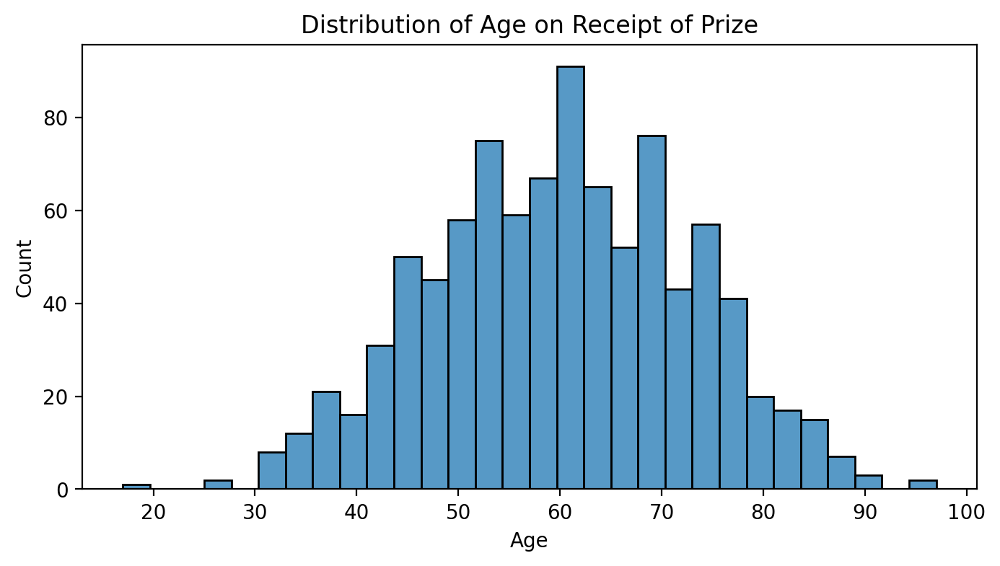

In [110]:
plt.figure(figsize=(8,4),dpi=200)
sns.histplot(data=df_data,
             x=df_data.winning_age,
             bins=30)
plt.xlabel('Age')
plt.title('Distribution of Age on Receipt of Prize')

plt.show()

### Age at Time of Award throughout History






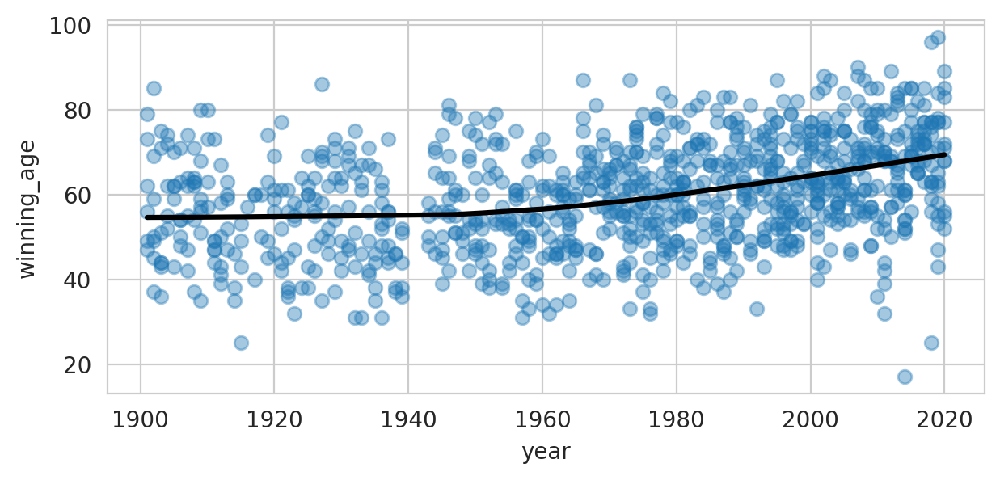

In [111]:
plt.figure(figsize=(7,3),dpi=200)
with sns.axes_style("whitegrid"):
  sns.regplot(data=df_data,
              x='year',
              y='winning_age',
              lowess=True,
              scatter_kws={'alpha':0.4},
              line_kws={'color':'black'})
plt.show()

From 1900 to around 1950, laureates were approximately 55 years old, but in recent times, they are closer to 70 years old when receiving their awards. Another notable observation in the chart is the increased spread over the last 10 years, with a rise in both very young and very old winners. In the 1950s and 60s, winners typically fell between 30 and 80 years old, while in recent years, this range has widened.

## Winning Age Across the Nobel Prize Categories
Utilized Seaborn's boxplot to visualize variations in mean, quartiles, maximum, and minimum values across categories.

In [ ]:
plt.figure(figsize=(7,2),dpi=200)
with sns.axes_style("whitegrid"):
  sns.boxplot(data=df_data,
              x='category',
              y='winning_age')
plt.show()

##Utilized Seaborn's lmplot with the row parameter to generate six separate charts, each dedicated to a specific prize category.




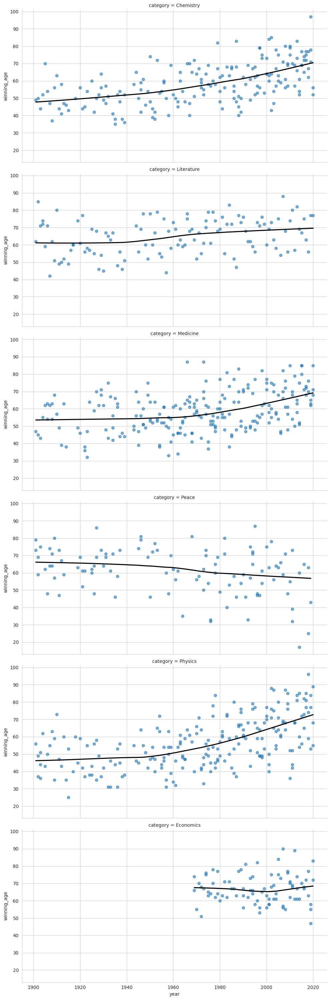

In [115]:
with sns.axes_style("whitegrid"):
  sns.lmplot(data=df_data,
             x='year',
             y='winning_age',
             row='category',
             lowess=True,
             aspect=2,
             scatter_kws={'alpha':0.6},
             line_kws={'color':'black'})
plt.show()

It is observed that winners in physics, chemistry, and medicine have seen an increase in age over time. The aging trend is most prominent in physics, where the average age has shifted from below 50 to over 70. In contrast, the newest category, Economics, demonstrates a more stable pattern. Conversely, the Peace Prize exhibits the opposite trend, with winners becoming younger over time.


Generated another chart with Seaborn's lmplot to display all six categories on a single chart, utilizing the hue parameter.

In [ ]:
with sns.axes_style("whitegrid"):
  sns.lmplot(data=df_data,
             x='year',
             y='winning_age',
             hue='category',
             lowess=True,
             aspect=2,
             scatter_kws={'alpha':0.5},
             line_kws={'linewidth':5})
  plt.show()